In [3]:
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
#pio.renderers.default = 'colab'   # try changing this in case your plots aren't shown
import pandas as pd
from urllib.request import urlopen
import json

zurich_household_income = pd.read_csv('Economic/zurich_household_income_quartier.csv')
zurich_individual_income = pd.read_csv('Economic/zurich_individual_income_ytd_median.csv')
zurich_individual_asset = pd.read_csv('Economic/zurich_individual_asset_ytd_median.csv')
zurich_popul = pd.read_csv('Population/zurich_popul_ytd_sum.csv')
zurich_hh = pd.read_csv('Population/zurich_quartiers_household_count.csv') 
zurich_populden = pd.read_csv('Population/zurich_populden_ytd.csv')

bedeutungsmean_url = "https://www.ogd.stadt-zuerich.ch/wfs/geoportal/Bedeutungsplan?service=WFS&version=1.1.0&request=GetFeature&outputFormat=GeoJSON&typename=view_bedeutungsplan_aktuell"

with open("zh_json.json") as response:
    geo_data = json.load(response)

In [46]:
zurich_popul_bySex = (
    zurich_popul.groupby(["QuarLang", "SexLang"])
    .agg("sum")
    .reset_index()
)
zurich_popul_bySex.drop(['AlterV10Sort', 'Unnamed: 0'], inplace=True, axis=1, errors='ignore')

In [47]:
zurich_popul_sum = (
    zurich_popul.groupby(["QuarLang"])
    .agg("sum")
    .reset_index()
)
zurich_popul_sum.drop(['AlterV10Sort', 'Unnamed: 0'], inplace=True, axis=1, errors='ignore')
zurich_popul_sum.head() # no. of population by quartier

,QuarLang,AnzBestWir
0,Affoltern,26935
1,Albisrieden,22875
2,Alt-Wiedikon,18079
3,Altstetten,35642
4,City,820


In [158]:
zurich_populden['QuarLang'] = zurich_populden['RaumLang']

df_popul_den_income = pd.merge(zurich_popul_sum, zurich_populden, how='left', on='QuarLang')
df_popul_den_income = pd.merge(df_popul_den_income, zurich_household_income, how='left', on='QuarLang')

df_popul_den_income.drop(
    ['Unnamed: 0_x', 'RaumKategorie', 'RaumSort',
       'RaumLang', 'StichtagDatJahr', 'AnzBestWir_y', 'Unnamed: 0_y'],
    inplace=True,
    axis=1,
    errors="ignore",
)
df_popul_den_income = df_popul_den_income.rename(columns={'AnzBestWir_x': 'Population', 'DichteS': 'Density_per_settlement_area'}, errors="raise")
df_popul_den_income.to_csv('population_density_income.csv')
df_popul_den_income.head()

,QuarLang,Population,FlaecheT,FlaecheL,FlaecheS,DichteT,DichteL,Density_per_settlement_area,HHincome_median
0,Affoltern,26935,604.4,495.3,217.1,44.6,54.4,124.0,45.2
1,Albisrieden,22875,460.1,271.6,175.5,49.7,84.2,130.3,51.0
2,Alt-Wiedikon,18079,169.2,161.7,121.0,106.8,111.8,149.4,61.2
3,Altstetten,35642,745.5,565.9,357.3,47.8,63.0,99.7,49.6
4,City,820,59.5,54.9,30.0,13.8,14.9,27.3,70.7


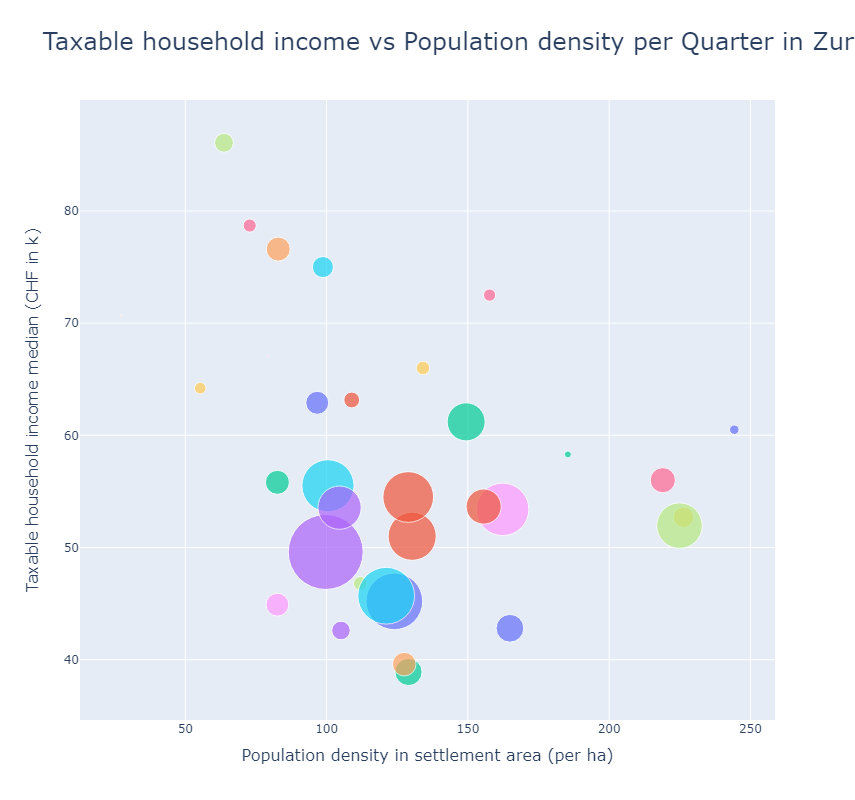

In [140]:
fig_popul_den_income = go.Figure()

quartiers = zurich_popul_sum["QuarLang"].unique().tolist()

for quartier in quartiers:
    df4_aux = df_popul_den_income[df_popul_den_income['QuarLang']==quartier]
    fig_popul_den_income.add_traces(
        go.Scatter(
            x=df4_aux['DichteS'], y=df4_aux['HHincome_median'], 
            mode="markers", 
            name=quartier, showlegend=False ,
            marker={"size": df4_aux['Population'], 'symbol': 'circle',
                    "sizeref": 2*max(df_popul_den_income['Population']/150), "sizemode": "diameter"
                   },
            text=df4_aux['QuarLang'],
            hovertemplate="<b>%{text}</b><br><br>" +
                "Taxable household income median (CHF in k): %{y:.1f}<br>" +
                "Population density in settlement area (per ha): %{x:.1f}<br>" +
                "Population: %{marker.size:,}" +
                "<extra></extra>"
        )
    )

fig_popul_den_income.update_layout(
    title={"text": "Taxable household income vs Population density per Quarter in Zurich", "font": {"size": 24}},
    xaxis={"title": {"text": "Population density in settlement area (per ha)", "font": {"size": 16}}},
    yaxis={"title": {"text": "Taxable household income median (CHF in k)", "font": {"size": 16}}},
)

fig_popul_den_income.layout.height = 800
fig_popul_den_income.layout.width = 1200
    
fig_popul_den_income.show()

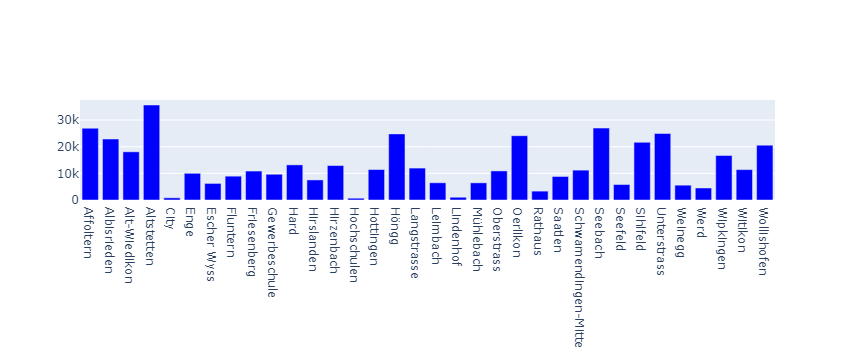

In [163]:
quartiers = zurich_popul_sum["QuarLang"].unique().tolist()

fig = go.Figure()
for quartier in quartiers:
    
    fig.add_trace(
        go.Bar(name=quartier, x=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['QuarLang'], 
                   y=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['Population'],
               hovertemplate="Quartier: %{x}<br>Population: %{y:.1f}", showlegend=False, marker= {"color": "blue"})
    )
    
fig.show()

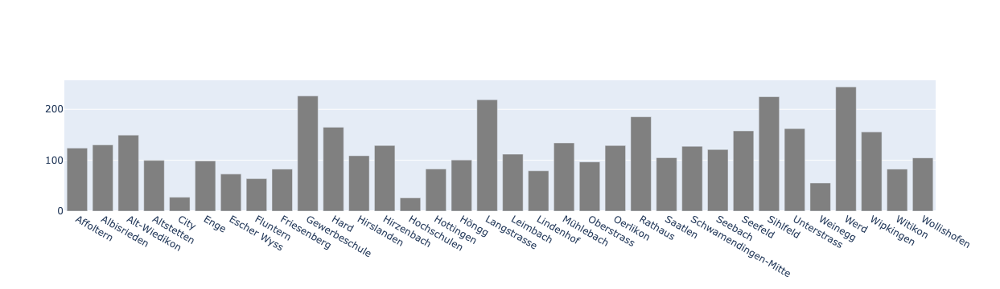

In [161]:
quartiers = zurich_popul_sum["QuarLang"].unique().tolist()

fig = go.Figure()
for quartier in quartiers:
    
    fig.add_trace(
        go.Bar(name=quartier, x=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['QuarLang'], 
                   y=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['Density_per_settlement_area'],
               hovertemplate="Quartier: %{x}<br>Population: %{y:.1f}", showlegend=False, marker= {"color": "gray"})
    )
    
fig.show()

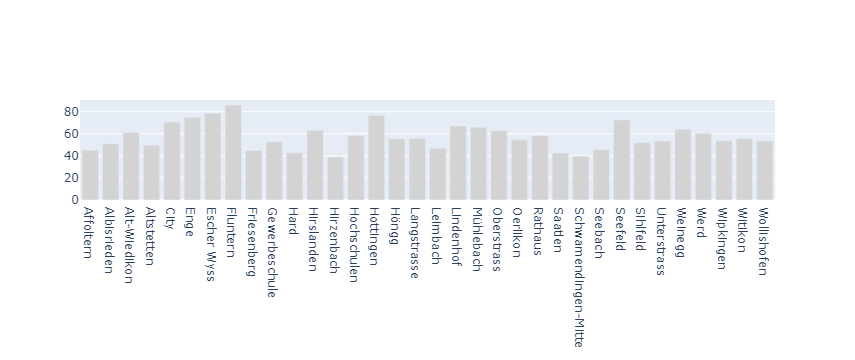

In [162]:
quartiers = zurich_popul_sum["QuarLang"].unique().tolist()

fig = go.Figure()
for quartier in quartiers:
    
    fig.add_trace(
        go.Bar(name=quartier, x=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['QuarLang'], 
                   y=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['HHincome_median'],
               hovertemplate="Quartier: %{x}<br>Population: %{y:.1f}", showlegend=False, marker= {"color": "lightgray"})
    )
    
fig.show()

In [ ]:
# quartiers = zurich_popul_sum["QuarLang"].unique().tolist()

# fig = go.Figure(
#             data = [
#                 for quartier in quartiers:
                
#     fig.add_trace(
#         data = [
#             go.Bar(name=quartier, x=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['QuarLang'], 
#                    y=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['Population'], 
#                    hovertemplate="Quartier: %{x}<br>Population: %{y:.1f}", showlegend=False, marker_color="gray"}), 
            
#             go.Bar(name=quartier, x=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['QuarLang'], 
#                    y=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['Density_per_settlement_area'], 
#                    hovertemplate="Quartier: %{x}<br>Population: %{y:.1f}", showlegend=False, marker_color="lightgray"}), 
            
#             go.Bar(name=quartier, x=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['QuarLang'], 
#                    y=df_popul_den_income[df_popul_den_income['QuarLang']==quartier]['HHincome_median'], 
#                    hovertemplate="Quartier: %{x}<br>Population: %{y:.1f}", showlegend=False, marker_color="blue"})
#         ], 
#     )
# )
# fig.show()

# # zurich_household_income_quartier = pd.DataFrame(columns=["QuarLang", "HHincome_median"])
# # zurich_household_income_quartier["QuarLang"] = quartiers

# # for quartier in quartiers:
# #     df_quartier = zurich_household_merge_summary[
# #         zurich_household_merge_summary["QuarLang"] == quartier
# #     ]
# #     df_quartier.sort_values("aequEK_p50", inplace=True)
# #     cumsum = df_quartier.AnzHH.cumsum()
# #     cutoff = df_quartier.AnzHH.sum() / 2.0
# #     median = df_quartier.aequEK_p50[cumsum >= cutoff].iloc[0]
# #     zurich_household_income_quartier.at[
# #         quartiers.index(quartier), "HHincome_median"
# #     ] = median

# # zurich_household_income_quartier.to_csv("zurich_household_income_quartier.csv")
# # zurich_household_income_quartier

# # fig = go.Figure(
# #     data=[
# #         go.Bar(name="quartier", x=df_au['year'], y=df_au['lifeExp']),
# #         go.Bar(name="Germany", x=df_de['year'], y=df_de['lifeExp']),
# #         go.Bar(name="Switzerland", x=df_ch['year'], y=df_ch['lifeExp'])
# #     ]
# # )
# # fig.show()

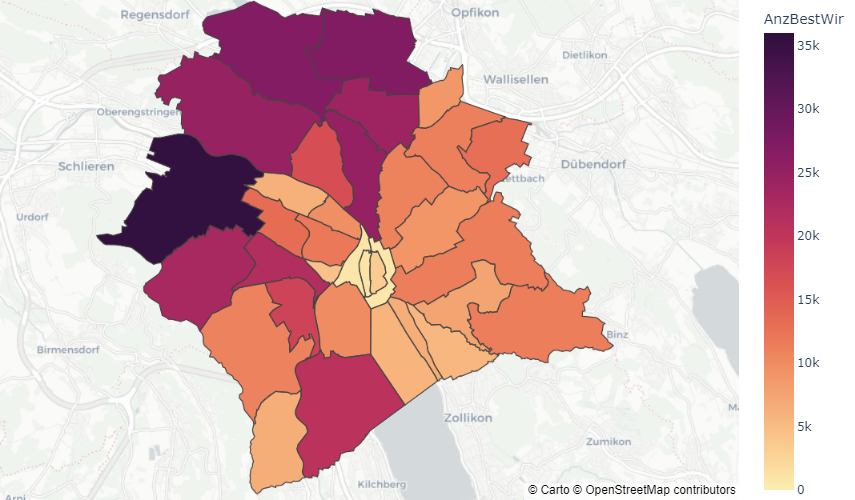

In [165]:
fig = zurich_popul_sum
fig_color = zurich_popul_sum['AnzBestWir'] # no. of population by quartier

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='matter', range_color=[0, 36000], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_popul = fig_zurich
fig_zurich_popul.show()

In [50]:
zurich_hh.head() # no. of households in zurich by quartier

,Unnamed: 0,QuarLang,AnzHH,AnzBestWir
0,0,Affoltern,11549,25658
1,1,Albisrieden,10877,21803
2,2,Alt-Wiedikon,8876,17012
3,3,Altstetten,16869,33331
4,4,City,310,702


In [31]:
branch_df=pd.read_csv("./all_branches.csv")
denner_df=branch_df[branch_df["name"]== "Denner"]
coop_df=branch_df[branch_df["name"]== "Coop"]
migros_df=branch_df[branch_df["name"]== "Migros"]
migros_df

,Unnamed: 0,name,address,post_codes,lat,long
160,0,Migros,Wengistrasse 7 8004 Zürich,8004,47.374972,8.523026
161,1,Migros,Sihlpassage 8004 Zürich,8004,47.380756,8.517289
162,2,Migros,Zollstrasse 6 8005 Zürich,8005,47.379818,8.536949
163,3,Migros,Löwenstrasse 31 - 35 8001 Zürich,8001,47.375383,8.536080
164,4,Migros,Limmatstrasse 152 8005 Zürich,8005,47.385878,8.531285
165,5,Migros,Hauptbahnhof 8001 Zürich,8001,47.378364,8.538358
166,6,Migros,Shop Ville 8001 Zürich,8001,47.378364,8.538358
167,7,Migros,Birmensdorferstrasse 140 8003 Zürich,8003,47.370182,8.520144
168,8,Migros,Stockerstrasse 47 8002 Zürich,8002,47.368291,8.534111
169,9,Migros,Badenerstrasse 376 8004 Zürich,8004,47.379102,8.508785


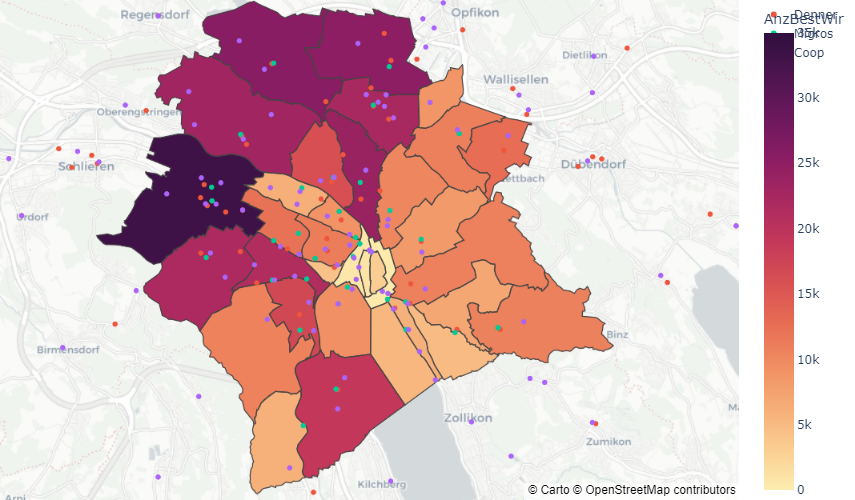

In [32]:
fig = zurich_hh
fig_color = zurich_hh['AnzBestWir'] # no. of households in zurich by quartier

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='matter', range_color=[0, 35000], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich.add_scattermapbox( mode = "markers", lat=denner_df.lat,
                           lon=denner_df.long, fillcolor = "red", name= "Denner", 
                             hovertext  =  "Denner")
fig_zurich.add_scattermapbox( mode = "markers", lat=migros_df.lat,
                           lon=migros_df.long, fillcolor = "blue", name= "Migros",  hovertext  =  "Migros")
fig_zurich.add_scattermapbox( mode = "markers", lat=coop_df.lat,
                           lon=coop_df.long, fillcolor = "red", name= "Coop", hovertext  =  "Coop")
fig_zurich_hh = fig_zurich
fig_zurich_hh.show()

In [84]:
zurich_populden.head()

,Unnamed: 0,RaumKategorie,RaumSort,RaumLang,StichtagDatJahr,AnzBestWir,FlaecheT,FlaecheL,FlaecheS,DichteT,DichteL,DichteS
0,195,Stadtquartier,11,Rathaus,2022,3330,35.7,27.4,18.0,93.2,121.3,185.4
1,209,Stadtquartier,12,Hochschulen,2022,676,58.1,46.0,25.9,11.6,14.7,26.1
2,223,Stadtquartier,13,Lindenhof,2022,1034,26.7,26.6,13.1,38.8,38.8,79.2
3,237,Stadtquartier,14,City,2022,820,59.5,54.9,30.0,13.8,14.9,27.3
4,251,Stadtquartier,21,Wollishofen,2022,20570,578.1,347.2,196.6,35.6,59.2,104.6


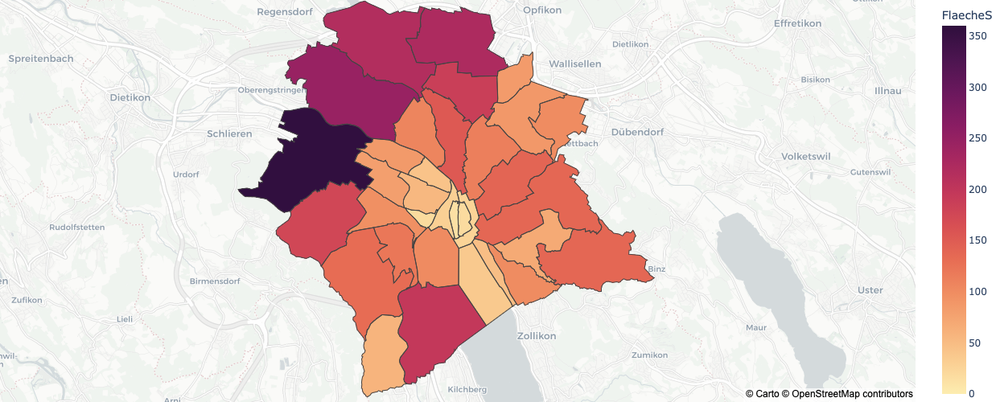

In [103]:
fig = zurich_populden
fig_color = zurich_populden['FlaecheS'] # Settlement area in ha (integer)

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='matter', range_color=[0, 360], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_settlementarea = fig_zurich
fig_zurich_settlementarea.show()

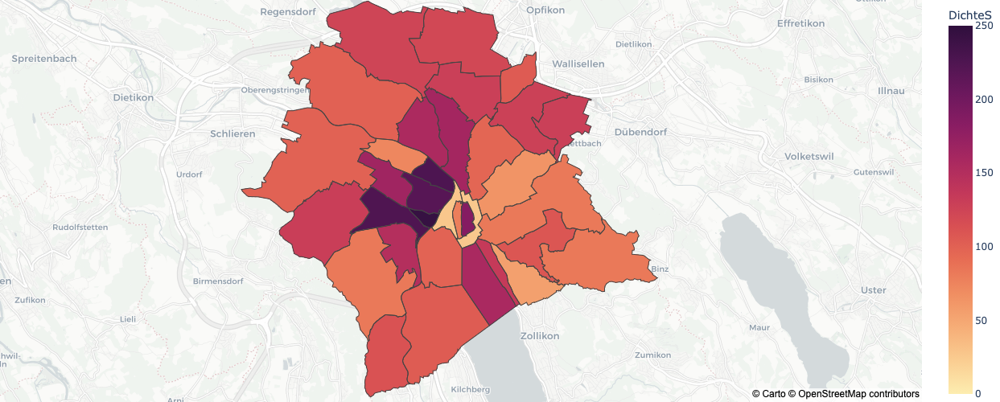

In [88]:
fig = zurich_populden
fig_color = zurich_populden['DichteS'] # Population density in people per ha (integer)

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['RaumLang'], featureidkey="properties.qname", 
                           color_continuous_scale='matter', range_color=[0, 250], 
                           hover_name=fig['RaumLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_populden = fig_zurich
fig_zurich_populden.show()

In [53]:
zurich_household_income.head() # household income median by quartier

,Unnamed: 0,QuarLang,HHincome_median
0,0,Affoltern,45.2
1,1,Albisrieden,51.0
2,2,Alt-Wiedikon,61.2
3,3,Altstetten,49.6
4,4,City,70.7


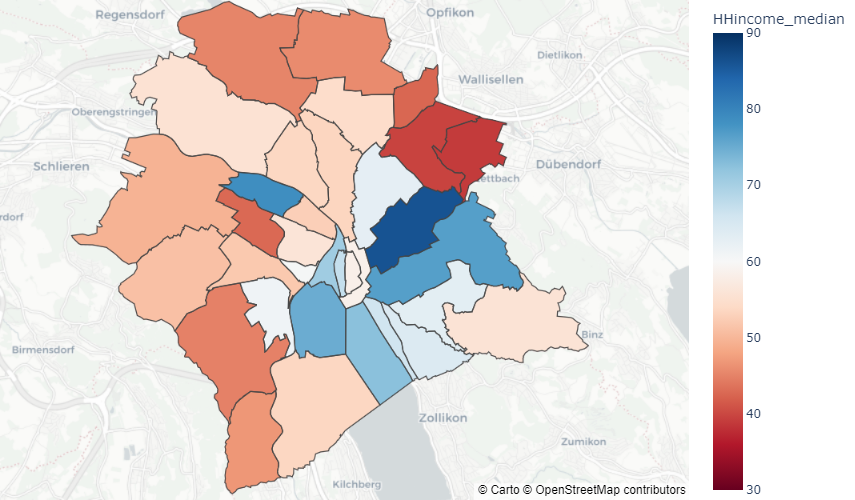

In [93]:
fig = zurich_household_income
fig_color = zurich_household_income['HHincome_median'] # household income median by quartier

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='RdBu', range_color=[30, 90], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_household_income = fig_zurich
fig_zurich_household_income.show()

In [66]:
zurich_individual_asset.head()

,Unnamed: 0,QuarLang,SteuerTarifLang,StichtagDatJahr,QuarSort,QuarCd,SteuerTarifSort,SteuerTarifCd,SteuerVermoegen_p50,SteuerVermoegen_p25,SteuerVermoegen_p75
0,0,Affoltern,Single-parent,2020.0,111.0,111.0,2.0,2.0,4.0,0.0,63.5
1,1,Affoltern,Basic single,2020.0,111.0,111.0,0.0,0.0,20.0,0.0,119.0
2,2,Affoltern,Married person,2020.0,111.0,111.0,1.0,1.0,93.0,4.0,334.0
3,3,Albisrieden,Single-parent,2020.0,91.0,91.0,2.0,2.0,49.0,3.0,198.0
4,4,Albisrieden,Basic single,2020.0,91.0,91.0,0.0,0.0,45.0,4.0,184.0


In [75]:
zurich_individual_asset_singleparent = zurich_individual_asset[zurich_individual_asset['SteuerTarifLang'] == 'Single-parent']
zurich_individual_asset_basicsingle = zurich_individual_asset[zurich_individual_asset['SteuerTarifLang'] == 'Basic single']
zurich_individual_asset_marriedperson = zurich_individual_asset[zurich_individual_asset['SteuerTarifLang'] == 'Married person']

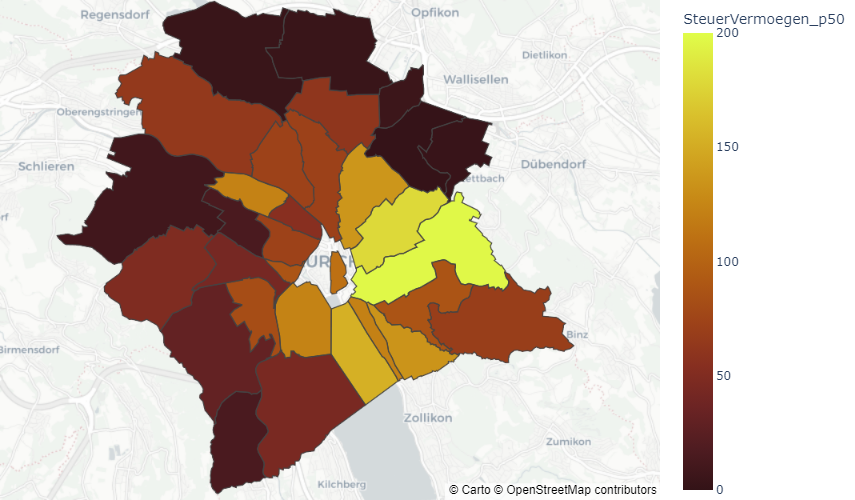

In [96]:
fig = zurich_individual_asset_singleparent
fig_color = zurich_individual_asset_singleparent['SteuerVermoegen_p50'] # household income median by quartier

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='solar', range_color=[0, 200], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_individual_asset_singleparent = fig_zurich
fig_zurich_individual_asset_singleparent.show()

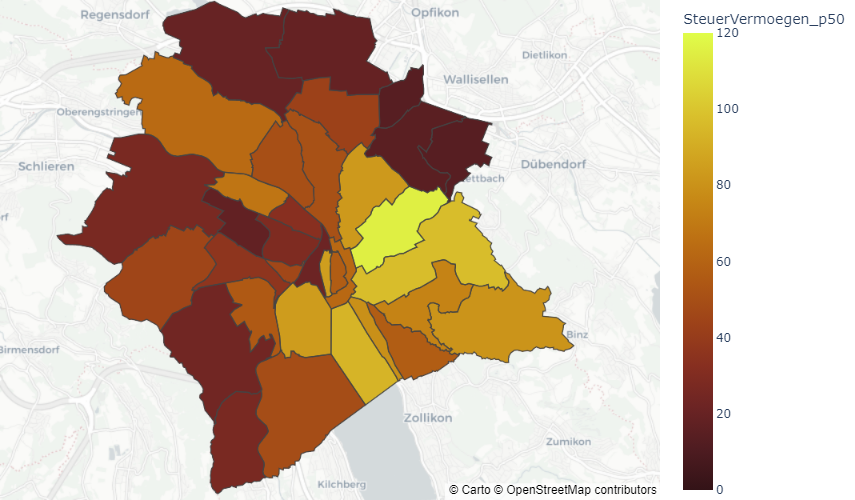

In [95]:
fig = zurich_individual_asset_basicsingle
fig_color = zurich_individual_asset_basicsingle['SteuerVermoegen_p50']

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='solar', range_color=[0, 120], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_individual_asset_basicsingle = fig_zurich
fig_zurich_individual_asset_basicsingle.show()

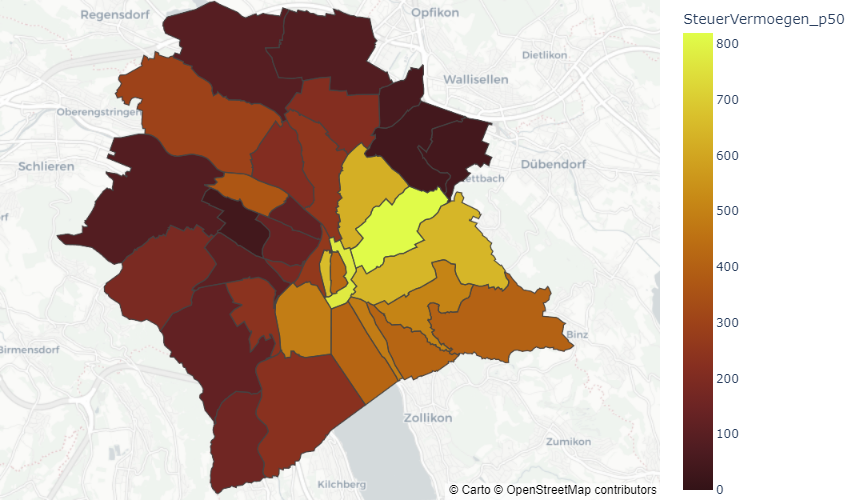

In [94]:
fig = zurich_individual_asset_marriedperson
fig_color = zurich_individual_asset_marriedperson['SteuerVermoegen_p50']

fig_zurich = px.choropleth_mapbox(fig, geojson=geo_data, color=fig_color,
                           locations=fig['QuarLang'], featureidkey="properties.qname", 
                           color_continuous_scale='solar', range_color=[0, 820], 
                           hover_name=fig['QuarLang'])

fig_zurich.update_layout(mapbox_style="carto-positron", 
                   mapbox_zoom=11, mapbox_center = {"lat": 47.3769, "lon": 8.5417})
                   
fig_zurich.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig_zurich.layout.height = 500
fig_zurich.layout.width = 1000
fig_zurich_individual_asset_marriedperson = fig_zurich
fig_zurich_individual_asset_marriedperson.show()